#Liberaries


In [1]:
# necessary libraries

import pandas as pd
import numpy as np
import seaborn as sns
sns.set()
import matplotlib.pyplot as plt
import plotly.express as px
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import matplotlib.pyplot as plt
from sklearn.metrics import precision_recall_curve
from sklearn.model_selection import train_test_split
import pickle

#preprossing
from sklearn.preprocessing import StandardScaler, PolynomialFeatures,LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split, GridSearchCV, learning_curve, cross_val_score
from sklearn.model_selection import learning_curve
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error, mean_absolute_percentage_error
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.preprocessing import LabelEncoder, FunctionTransformer
#Algorithms
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVR
from xgboost import XGBClassifier
from sklearn.inspection import permutation_importance
from sklearn.multioutput import MultiOutputClassifier
from sklearn.ensemble import RandomForestClassifier,RandomForestRegressor, GradientBoostingClassifier, AdaBoostClassifier, ExtraTreesClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
#evaluate model
from sklearn.metrics import (confusion_matrix,classification_report,
                             accuracy_score, precision_score,
                             recall_score, f1_score, roc_auc_score, roc_curve,
                             log_loss, balanced_accuracy_score, matthews_corrcoef,
                             cohen_kappa_score, fbeta_score, hamming_loss,
                             jaccard_score, brier_score_loss)
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.metrics import classification_report, make_scorer
from IPython.core.debugger import set_trace

import warnings
warnings.filterwarnings('ignore')

#Load Data

In [2]:
# load data
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
data=pd.read_csv('/content/drive/MyDrive/ASD/Detect_Children/Autism-Child-Data.csv',index_col=False)
data.head()

,A1_Score,A2_Score,A3_Score,A4_Score,A5_Score,A6_Score,A7_Score,A8_Score,A9_Score,A10_Score,...,gender,ethnicity,jundice,autism,contry_of_res,used_app_before,result,age_desc,relation,Class/ASD
0,1,1,0,0,1,1,0,1,0,0,...,m,Others,no,no,Jordan,no,5,'4-11 years',Parent,NO
1,1,1,0,0,1,1,0,1,0,0,...,m,'Middle Eastern ',no,no,Jordan,no,5,'4-11 years',Parent,NO
2,1,1,0,0,0,1,1,1,0,0,...,m,?,no,no,Jordan,yes,5,'4-11 years',?,NO
3,0,1,0,0,1,1,0,0,0,1,...,f,?,yes,no,Jordan,no,4,'4-11 years',?,NO
4,1,1,1,1,1,1,1,1,1,1,...,m,Others,yes,no,'United States',no,10,'4-11 years',Parent,YES


#DataPreprossing

In [4]:
# Verify column names
print("Column names:", data.columns)
data.info()
data.shape

Column names: Index(['A1_Score', 'A2_Score', 'A3_Score', 'A4_Score', 'A5_Score', 'A6_Score',
       'A7_Score', 'A8_Score', 'A9_Score', 'A10_Score', 'age', 'gender',
       'ethnicity', 'jundice', 'autism', 'contry_of_res', 'used_app_before',
       'result', 'age_desc', 'relation', 'Class/ASD'],
      dtype='object')
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 292 entries, 0 to 291
Data columns (total 21 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   A1_Score         292 non-null    int64 
 1   A2_Score         292 non-null    int64 
 2   A3_Score         292 non-null    int64 
 3   A4_Score         292 non-null    int64 
 4   A5_Score         292 non-null    int64 
 5   A6_Score         292 non-null    int64 
 6   A7_Score         292 non-null    int64 
 7   A8_Score         292 non-null    int64 
 8   A9_Score         292 non-null    int64 
 9   A10_Score        292 non-null    int64 
 10  age              292 non-null 

(292, 21)

In [5]:
data = data.drop(['result', 'age_desc'], axis=1)

In [6]:
data = data.rename(columns={'Class/ASD': 'ASD'})

In [7]:
data.duplicated().sum()

2

In [8]:
# data.drop_duplicates(inplace=True)

In [9]:
data.duplicated().sum()


2

In [10]:
data.shape

(292, 19)

In [11]:
# Function to find columns with a specific value
def get_columns_with_value(df, value):
    columns_with_value = [col for col in df.columns if df[col].eq(value).any()]
    return columns_with_value

# Get columns that contain the value '?'
columns_with_value = get_columns_with_value(data, '?')
print("\nColumns that contain the value '?':")
print(columns_with_value)



Columns that contain the value '?':
['age', 'ethnicity', 'relation']


In [12]:
# Replace specific data in specific columns with empty strings
value_to_replace = '?'  # Value to replace
columns_to_replace_in = ['age', 'ethnicity', 'relation']  # Replace with actual column names you want to replace in

# Replace the specific value with an empty string in the specified columns
for column in columns_to_replace_in:
    data.loc[data[column] == value_to_replace, column] = ''

In [13]:
data.head()

,A1_Score,A2_Score,A3_Score,A4_Score,A5_Score,A6_Score,A7_Score,A8_Score,A9_Score,A10_Score,age,gender,ethnicity,jundice,autism,contry_of_res,used_app_before,relation,ASD
0,1,1,0,0,1,1,0,1,0,0,6,m,Others,no,no,Jordan,no,Parent,NO
1,1,1,0,0,1,1,0,1,0,0,6,m,'Middle Eastern ',no,no,Jordan,no,Parent,NO
2,1,1,0,0,0,1,1,1,0,0,6,m,,no,no,Jordan,yes,,NO
3,0,1,0,0,1,1,0,0,0,1,5,f,,yes,no,Jordan,no,,NO
4,1,1,1,1,1,1,1,1,1,1,5,m,Others,yes,no,'United States',no,Parent,YES


In [14]:
data.isnull().sum()

,0
A1_Score,0
A2_Score,0
A3_Score,0
A4_Score,0
A5_Score,0
A6_Score,0
A7_Score,0
A8_Score,0
A9_Score,0
A10_Score,0


In [15]:
#Making classes of categorical variables same for all datasets
data["relation"] = data["relation"].replace('self','Self')

In [16]:
data['contry_of_res']

,contry_of_res
0,Jordan
1,Jordan
2,Jordan
3,Jordan
4,'United States'
...,...
287,'United Kingdom'
288,Australia
289,Brazil
290,India


In [17]:
data['contry_of_res'] = data['contry_of_res'].str.replace(r'[\'"]', '', regex=True).str.replace(' ','')
data['contry_of_res']

,contry_of_res
0,Jordan
1,Jordan
2,Jordan
3,Jordan
4,UnitedStates
...,...
287,UnitedKingdom
288,Australia
289,Brazil
290,India


In [18]:
# data['ASD']= data['ASD'].replace('YES','1',inplace=True)
data.loc[data['ASD'] == 'YES', 'ASD']=1
data.loc[data['ASD'] == 'NO', 'ASD']=0
data['ASD']= pd.to_numeric(data['ASD'])
data['ASD']

,ASD
0,0
1,0
2,0
3,0
4,1
...,...
287,1
288,0
289,1
290,1


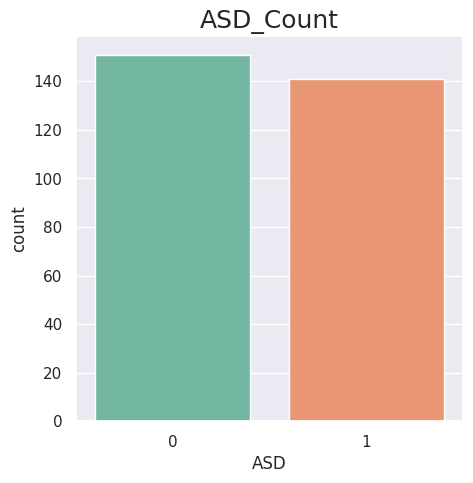

,count
ASD,
0,151
1,141


In [19]:
plt.figure(figsize=(5, 5))
sns.countplot(x='ASD', data=data,palette='Set2')
plt.title('ASD_Count', fontsize=18)
plt.savefig('/content/drive/MyDrive/ASD/Detect_Children/Features_figs/ASD_count.png')
plt.show()
data['ASD'].value_counts()

In [20]:
#get numeric data properities
data.describe()

,A1_Score,A2_Score,A3_Score,A4_Score,A5_Score,A6_Score,A7_Score,A8_Score,A9_Score,A10_Score,ASD
count,292.000000,292.000000,292.000000,292.000000,292.000000,292.000000,292.000000,292.000000,292.000000,292.000000,292.000000
mean,0.633562,0.534247,0.743151,0.551370,0.743151,0.712329,0.606164,0.496575,0.493151,0.726027,0.482877
std,0.482658,0.499682,0.437646,0.498208,0.437646,0.453454,0.489438,0.500847,0.500811,0.446761,0.500565
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000
75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [21]:
#get categorical data properities
data.describe(include='O')

,age,gender,ethnicity,jundice,autism,contry_of_res,used_app_before,relation
count,292,292,292,292,292,292,292,292
unique,9,2,11,2,2,52,2,5
top,4,m,White-European,no,no,UnitedKingdom,no,Parent
freq,92,208,108,212,243,49,281,214


In [22]:
data.isnull().sum().sum()

0

#Features(X)and target(Y)

In [23]:
# Split features and target
X = data.drop(columns=['ASD'])
y = data['ASD']


In [24]:
X.shape

(292, 18)

In [25]:
y.shape

(292,)

In [26]:
numerical_data=X.select_dtypes(include=[np.number]).columns
numerical_data

Index(['A1_Score', 'A2_Score', 'A3_Score', 'A4_Score', 'A5_Score', 'A6_Score',
       'A7_Score', 'A8_Score', 'A9_Score', 'A10_Score'],
      dtype='object')

In [27]:
categorical_data=X.select_dtypes(include=[object]).columns
categorical_data

Index(['age', 'gender', 'ethnicity', 'jundice', 'autism', 'contry_of_res',
       'used_app_before', 'relation'],
      dtype='object')

In [28]:
# Impute missing values in numeric columns with the mean
numeric_imputer = SimpleImputer(strategy='mean')
data[numerical_data] = numeric_imputer.fit_transform(data[numerical_data])

# Impute missing values in categorical columns with the most frequent value
categorical_imputer = SimpleImputer(strategy='most_frequent')
data[categorical_data] = categorical_imputer.fit_transform(data[categorical_data])

# Display the modified DataFrame with the original headers
print("\nDataFrame after imputing missing values:")
print(data.head())


DataFrame after imputing missing values:
   A1_Score  A2_Score  A3_Score  A4_Score  A5_Score  A6_Score  A7_Score  \
0       1.0       1.0       0.0       0.0       1.0       1.0       0.0   
1       1.0       1.0       0.0       0.0       1.0       1.0       0.0   
2       1.0       1.0       0.0       0.0       0.0       1.0       1.0   
3       0.0       1.0       0.0       0.0       1.0       1.0       0.0   
4       1.0       1.0       1.0       1.0       1.0       1.0       1.0   

   A8_Score  A9_Score  A10_Score age gender          ethnicity jundice autism  \
0       1.0       0.0        0.0   6      m             Others      no     no   
1       1.0       0.0        0.0   6      m  'Middle Eastern '      no     no   
2       1.0       0.0        0.0   6      m                         no     no   
3       0.0       0.0        1.0   5      f                        yes     no   
4       1.0       1.0        1.0   5      m             Others     yes     no   

  contry_of_res used

In [29]:
data.isnull().sum()

,0
A1_Score,0
A2_Score,0
A3_Score,0
A4_Score,0
A5_Score,0
A6_Score,0
A7_Score,0
A8_Score,0
A9_Score,0
A10_Score,0


In [30]:
# Print the name of each feature
print("Feature names:")
for i, feature in enumerate(X.columns, start=1):
    print(f'X{i-1} is {feature}')

Feature names:
X0 is A1_Score
X1 is A2_Score
X2 is A3_Score
X3 is A4_Score
X4 is A5_Score
X5 is A6_Score
X6 is A7_Score
X7 is A8_Score
X8 is A9_Score
X9 is A10_Score
X10 is age
X11 is gender
X12 is ethnicity
X13 is jundice
X14 is autism
X15 is contry_of_res
X16 is used_app_before
X17 is relation


In [31]:
copy_X=X

In [32]:
#Data Encoder
class MultiColumnLabelEncoder(BaseEstimator, TransformerMixin):
    def __init__(self, columns=None):
        self.columns = columns

    def fit(self, X, y=None):
        self.encoders = {col: LabelEncoder().fit(X[col]) for col in self.columns}
        return self

    def transform(self, X):
        X_copy = X.copy()
        for col in self.columns:
            X_copy[col] = self.encoders[col].transform(X_copy[col])
        return X_copy

# Apply the custom encoder
mcle = MultiColumnLabelEncoder(columns=['age', 'gender', 'ethnicity', 'jundice', 'autism', 'contry_of_res',
       'used_app_before', 'relation'])

X_label_encoded = mcle.fit_transform(copy_X)
print(X_label_encoded)

     A1_Score  A2_Score  A3_Score  A4_Score  A5_Score  A6_Score  A7_Score  \
0           1         1         0         0         1         1         0   
1           1         1         0         0         1         1         0   
2           1         1         0         0         0         1         1   
3           0         1         0         0         1         1         0   
4           1         1         1         1         1         1         1   
..        ...       ...       ...       ...       ...       ...       ...   
287         1         1         1         1         1         1         1   
288         1         0         0         0         1         0         1   
289         1         0         1         1         1         1         1   
290         1         1         1         0         1         1         1   
291         0         0         1         0         1         0         1   

     A8_Score  A9_Score  A10_Score  age  gender  ethnicity  jundice  autism

In [33]:
# Normalize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_label_encoded)
X_scaled

array([[ 0.76051192,  0.93369956, -1.70098011, ..., -0.37107938,
        -0.19785325,  0.29482457],
       [ 0.76051192,  0.93369956, -1.70098011, ..., -0.37107938,
        -0.19785325,  0.29482457],
       [ 0.76051192,  0.93369956, -1.70098011, ..., -0.37107938,
         5.05425114, -2.0965303 ],
       ...,
       [ 0.76051192, -1.07100832,  0.58789635, ..., -1.28498706,
        -0.19785325,  0.29482457],
       [ 0.76051192,  0.93369956,  0.58789635, ..., -0.71379476,
        -0.19785325,  0.29482457],
       [-1.31490378, -1.07100832,  0.58789635, ..., -0.71379476,
        -0.19785325,  0.29482457]])

#Feature Engineering

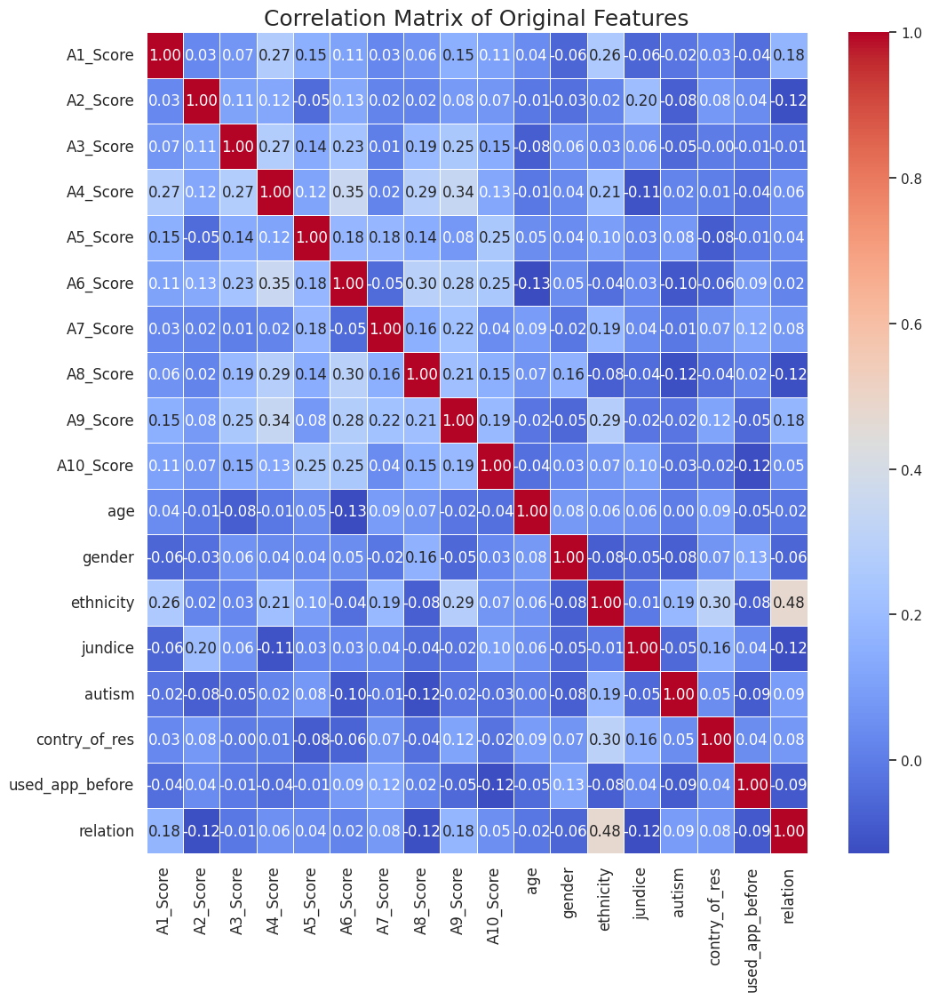

In [34]:
# Correlation matrix for original features (X_label_encoded)
plt.figure(figsize=(12, 12))
corr_matrix = X_label_encoded.corr()
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f',linewidth=.7)
plt.title('Correlation Matrix of Original Features', fontsize=18)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.savefig('/content/drive/MyDrive/ASD/Detect_Children/Features_figs/original_features_correlation_matrix.png')
plt.show()

In [35]:
# Feature engineering (e.g., adding polynomial features)
poly = PolynomialFeatures(degree=2, interaction_only=True)
X_poly = poly.fit_transform(X_scaled)
X_poly

array([[  1.        ,   0.76051192,   0.93369956, ...,   0.07341926,
         -0.10940332,  -0.058332  ],
       [  1.        ,   0.76051192,   0.93369956, ...,   0.07341926,
         -0.10940332,  -0.058332  ],
       [  1.        ,   0.76051192,   0.93369956, ...,  -1.87552838,
          0.77797916, -10.59639065],
       ...,
       [  1.        ,   0.76051192,  -1.07100832, ...,   0.25423886,
         -0.37884576,  -0.058332  ],
       [  1.        ,   0.76051192,   0.93369956, ...,   0.14122661,
         -0.21044424,  -0.058332  ],
       [  1.        ,  -1.31490378,  -1.07100832, ...,   0.14122661,
         -0.21044424,  -0.058332  ]])

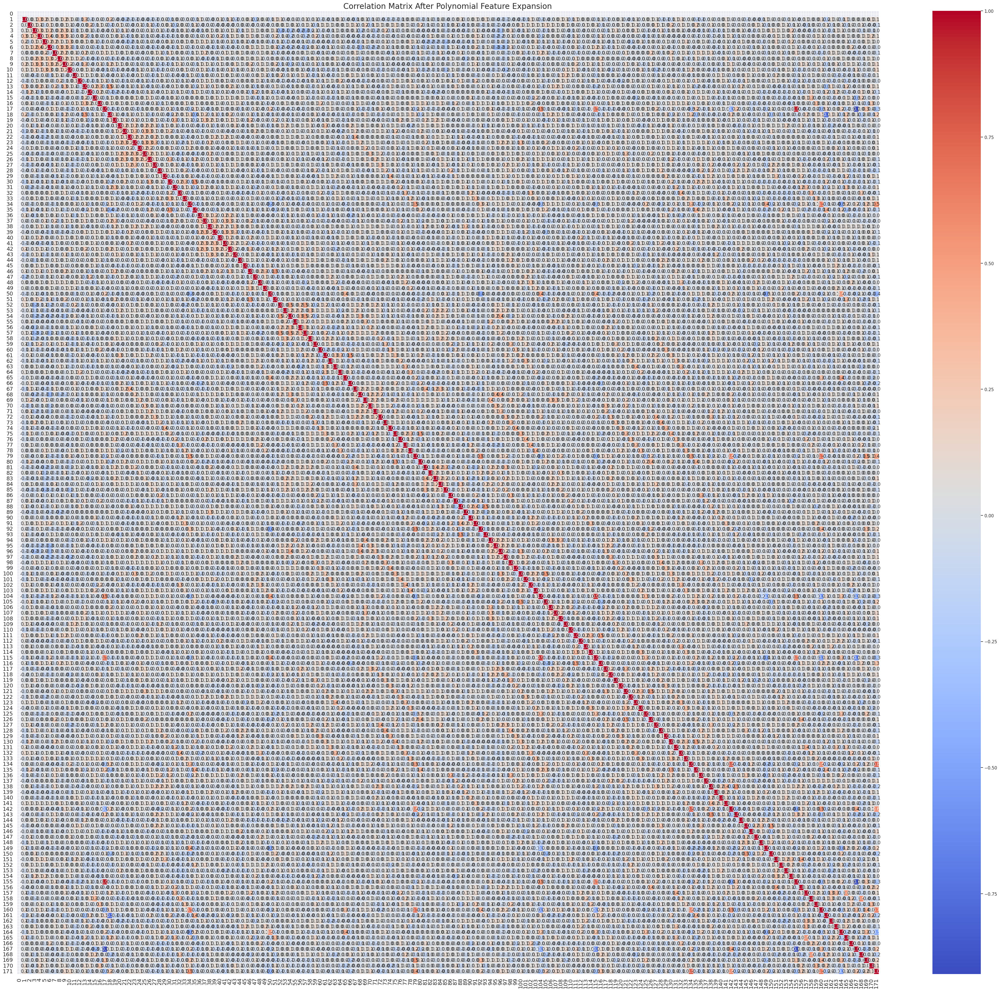

In [36]:
# Plot Correlation after Polynomial Feature Expansion (X_poly)
X_poly_df = pd.DataFrame(X_poly)
plt.figure(figsize=(50, 45))
sns.heatmap(X_poly_df.corr(), annot=True, cmap='coolwarm',fmt='.1f',linewidth=.5)
plt.title('Correlation Matrix After Polynomial Feature Expansion',fontsize=20)
plt.xticks(rotation=90,fontsize=14)
plt.yticks(rotation=0,fontsize=14)
plt.savefig('/content/drive/MyDrive/ASD/Detect_Children/Features_figs/polynomial features_correlation_matrix.png')
plt.show()

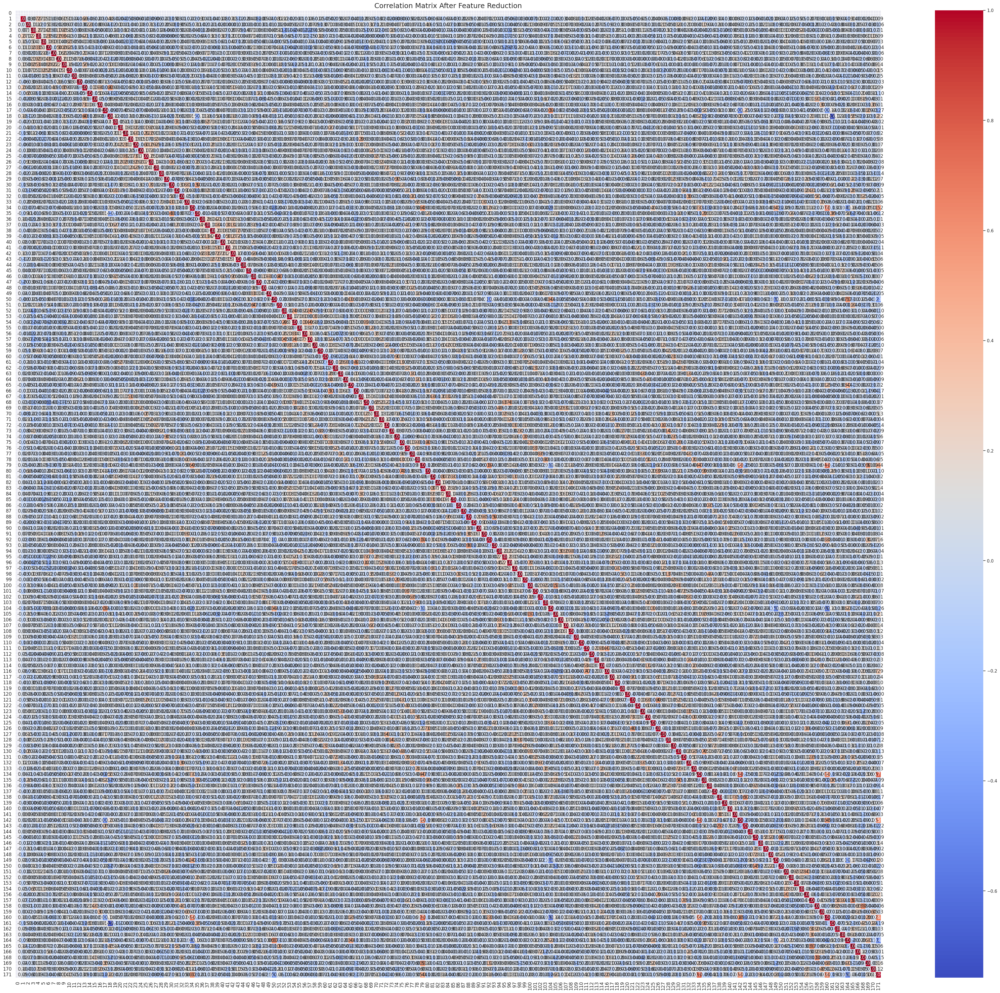

In [37]:
# Feature reduction based on correlation threshold
# Assuming X_poly_df is your DataFrame
threshold = 0.9  # Set your desired correlation threshold

# Calculate the correlation matrix
corr_matrix = X_poly_df.corr()
upper_triangle = np.triu(corr_matrix, k=1)  # Get upper triangle of correlation matrix

# Identify columns to drop based on threshold
high_corr_features = [i for i in range(len(X_poly_df.columns)) if any(np.abs(upper_triangle[:, i]) > threshold)]

# Drop the highly correlated columns
X_poly_reduced = X_poly_df.drop(columns=high_corr_features)


# Correlation matrix After Feature Reduction
# Assuming X_poly_reduced is your DataFrame after reduction
plt.figure(figsize=(50, 45))
corr_matrix1 = X_poly_reduced.corr()
sns.heatmap(corr_matrix1, annot=True, cmap='coolwarm', fmt='.2f', linewidth=.7)
plt.title('Correlation Matrix After Feature Reduction', fontsize=18)
plt.xticks(rotation=90, fontsize=12)
plt.yticks(rotation=0, fontsize=12)
plt.savefig('/content/drive/MyDrive/ASD/Detect_Children/Features_figs/Feature Reduction_correlation_matrix.png')
plt.show()

#Data augmentation


In [38]:
X_poly_reduced.shape

(292, 169)

In [39]:
# Data augmentation by adding noise
def add_noise(X, noise_level=0.01):
    noise = np.random.normal(0, noise_level, X.shape)
    return X + noise

# Augment the data
X_augmented = add_noise(X_poly_reduced, noise_level=0.01)
X_augmented.shape

# Integrate original and augmented data
X_combined = np.concatenate((X_poly_reduced, X_augmented))
y_combined = np.concatenate((y, y))

print("X_poly_reduced shape:", X_poly_reduced.shape)
print("X_augmented shape:", X_augmented.shape)
print("y shape:", y.shape)

print("X_combined shape:", X_combined.shape)
print("y_combined shape:", y_combined.shape)

X_poly_reduced shape: (292, 169)
X_augmented shape: (292, 169)
y shape: (292,)
X_combined shape: (584, 169)
y_combined shape: (584,)


#Feature selection

In [40]:
# Feature selection
k_best = SelectKBest(score_func=f_regression, k=30)

# Verify column names
print("K_best Scores before polynomial:", k_best)


K_best Scores before polynomial: SelectKBest(k=30, score_func=<function f_regression at 0x7f9f1967a3b0>)


In [41]:
X_selected = k_best.fit_transform(X_combined, y_combined)
X_selected


array([[ 0.76051192,  0.93369956, -1.70098011, ...,  0.26433637,
        -0.23581683, -0.10940332],
       [ 0.76051192,  0.93369956, -1.70098011, ..., -0.68857993,
        -0.23581683, -0.10940332],
       [ 0.76051192,  0.93369956, -1.70098011, ..., -0.84739931,
        -0.23581683,  0.77797916],
       ...,
       [ 0.7682409 , -1.07395821,  0.57575635, ...,  0.10429415,
        -0.81170573, -0.3692766 ],
       [ 0.75501842,  0.9446567 ,  0.59938579, ..., -0.52013378,
        -0.44325687, -0.22047457],
       [-1.3217682 , -1.05830015,  0.58100561, ...,  1.32275742,
         1.12266409, -0.21862673]])

In [42]:
# Finding the optimal value of k
def find_best_k(X, y, max_k=30):
    best_k = 1
    best_score = -np.inf
    scores = []

    for k in range(1, max_k+1):
        k_best = SelectKBest(score_func=f_regression, k=k)
        X_selected = k_best.fit_transform(X, y)

        # Using cross-validation to evaluate the performance of the selected features
        score = cross_val_score(RandomForestRegressor(), X_selected, y, cv=5, scoring='r2').mean()
        scores.append(score)

        if score > best_score:
            best_score = score
            best_k = k

    return best_k, scores

best_k, scores = find_best_k(X_combined, y_combined)

print(f'Optimal number of features: {best_k}')


Optimal number of features: 24


In [43]:
# Feature selection with optimal k
k_best = SelectKBest(score_func=f_regression, k=best_k)
X_selected = k_best.fit_transform(X_combined, y_combined)

# Get selected feature names
feature_names = poly.get_feature_names_out(X.columns)
selected_features = [feature_names[i] for i in k_best.get_support(indices=True)]

print('Selected Features:', selected_features)

Selected Features: ['A1_Score', 'A2_Score', 'A3_Score', 'A4_Score', 'A5_Score', 'A6_Score', 'A7_Score', 'A8_Score', 'A9_Score', 'A10_Score', 'ethnicity', 'A1_Score A3_Score', 'A2_Score A9_Score', 'A2_Score autism', 'A5_Score A9_Score', 'A5_Score jundice', 'A5_Score contry_of_res', 'A6_Score age', 'A7_Score ethnicity', 'A7_Score used_app_before', 'A8_Score contry_of_res', 'A8_Score used_app_before', 'A10_Score autism', 'gender autism']


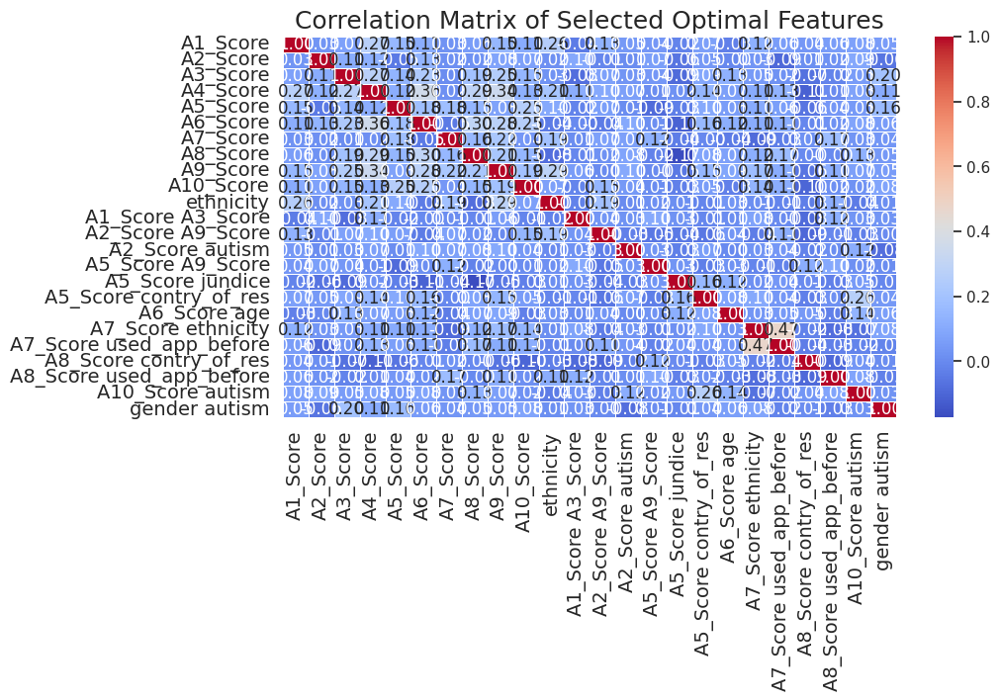

In [44]:
# Assuming the selected features are from the original dataset, we need to extract these from X_combined
selected_feature_indices = k_best.get_support(indices=True)

# Create a DataFrame for the selected features
selected_feature_names = [feature_names[i] for i in selected_feature_indices]
selected_features_df = pd.DataFrame(X_combined[:, selected_feature_indices], columns=selected_feature_names)

# Draw the correlation matrix of the selected features
plt.figure(figsize=(10, 5))
selected_corr_matrix = selected_features_df.corr()
sns.heatmap(selected_corr_matrix, annot=True, cmap='coolwarm', fmt='.2f',linewidth=.7)
plt.title('Correlation Matrix of Selected Optimal Features', fontsize=18)
plt.xticks(rotation=90, fontsize=14)
plt.yticks(fontsize=14)
plt.savefig('/content/drive/MyDrive/ASD/Detect_Children/Features_figs/selected_features_correlation_matrix.png')
plt.show()

# Save DataFrame to Excel
selected_features_df.to_excel('/content/drive/MyDrive/ASD/Detect_Children/selected_features.xlsx', index=False)


Features Score [106.50738223  32.19367185 108.05201086 277.08876783  98.22628324
 122.91233973  47.18694308 138.61268361 180.16018093 139.70719284
  16.30022373   9.13267384   6.31423092   7.03793948  12.61719609
   6.22422383  13.38119637  10.68234296  15.66751027   8.09456534
   6.39634662   7.11035675   9.2801421    6.37574735]


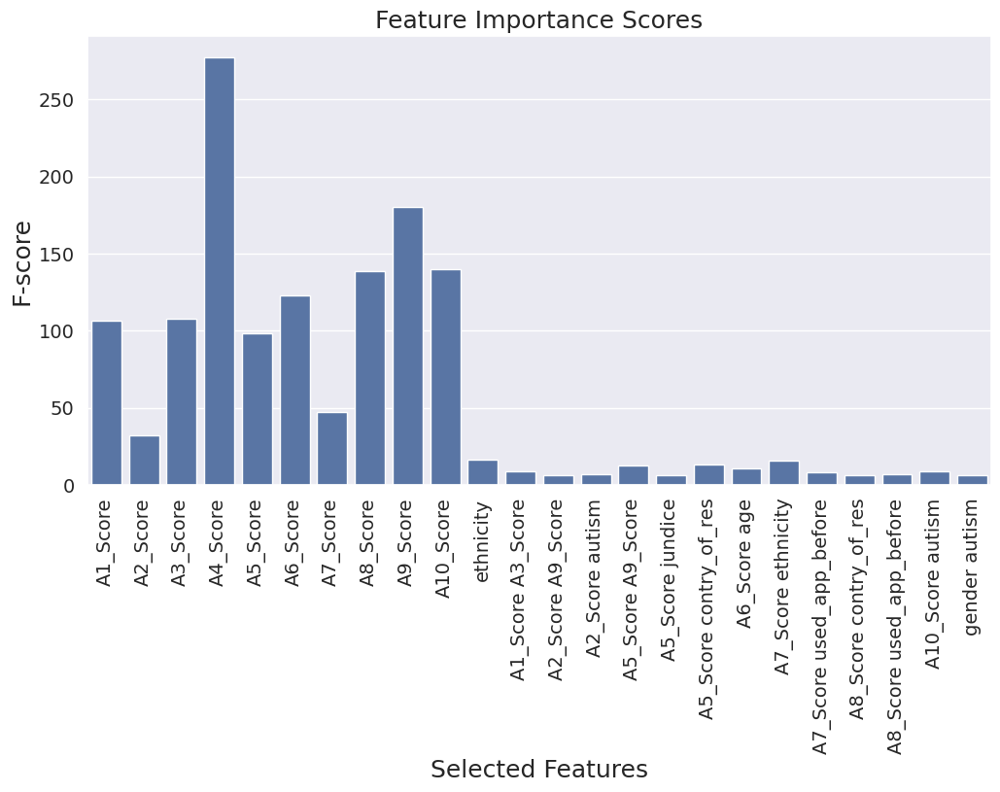

In [45]:
# Plot feature importances
feature_scores = k_best.scores_[k_best.get_support()]
print('Features Score', feature_scores)

#draw feature_importance
plt.figure(figsize=(12, 6))
sns.barplot(x=selected_features, y=feature_scores)
plt.xlabel('Selected Features', fontsize=18)
plt.ylabel('F-score', fontsize=18)
plt.title('Feature Importance Scores', fontsize=18)
plt.xticks(rotation=90, fontsize=14)
plt.yticks(rotation=0,fontsize=14)
plt.savefig('/content/drive/MyDrive/ASD/Detect_Children/Features_figs/feature_importance_scores.png')
plt.show()



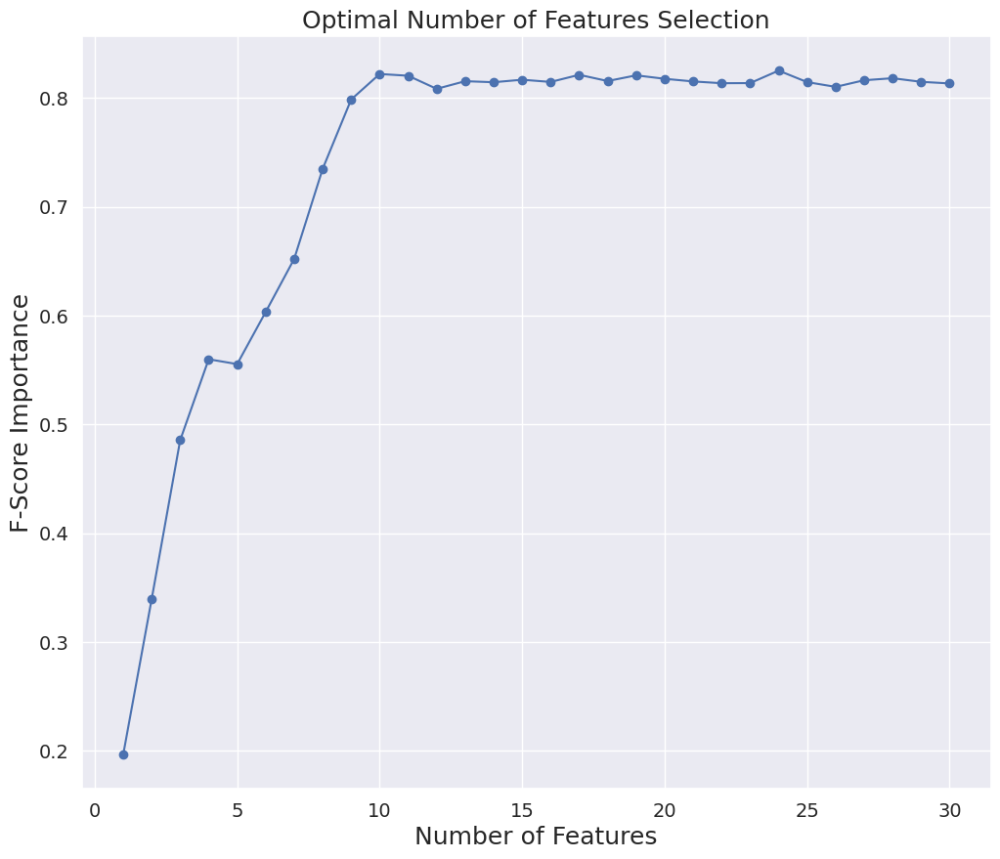

In [46]:
# Plot the scores for different values of k
plt.figure(figsize=(12, 10))
plt.plot(range(1, len(scores)+1), scores, marker='o')
plt.xlabel('Number of Features', fontsize=18)
plt.ylabel('F-Score Importance', fontsize=18)
plt.title('Optimal Number of Features Selection', fontsize=18)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.savefig('/content/drive/MyDrive/ASD/Detect_Children/Features_figs/optimal_number_of_features.png')
plt.show()


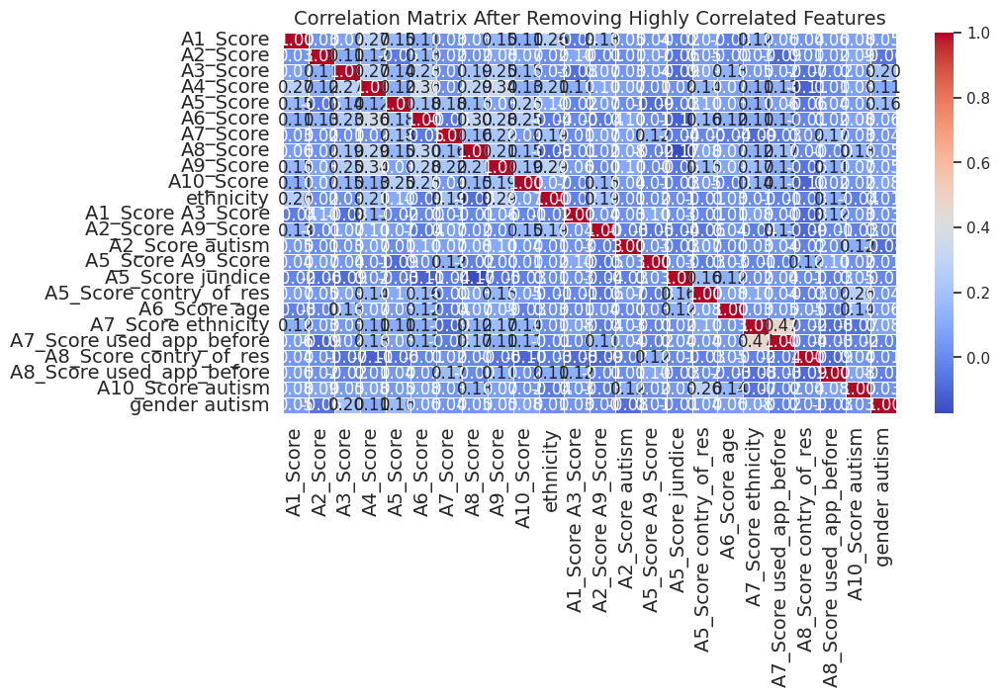

In [47]:
# Remove highly correlated features
def remove_highly_correlated_features(dataframe, threshold=0.85):
    corr_matrix = dataframe.corr().abs()
    upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
    to_drop = [column for column in upper.columns if any(upper[column] > threshold)]
    return dataframe.drop(columns=to_drop)

# Plot the correlation matrix for the reduced dataset
def plot_correlation_matrix(dataframe, title):
    plt.figure(figsize=(10, 5))
    corr_matrix = dataframe.corr()
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f',linewidth=.7)
    plt.title(title, fontsize=14)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.savefig('/content/drive/MyDrive/ASD/Detect_Children/Features_figs/correlation_matrix_after_removing.png')
    plt.show()

# Convert selected features to DataFrame
X_selected_df = pd.DataFrame(X_selected, columns=selected_features)
X_reduced = remove_highly_correlated_features(X_selected_df)

# Convert reduced data to DataFrame and plot correlation matrix
X_reduced_df = pd.DataFrame(X_reduced, columns=X_reduced.columns)
plot_correlation_matrix(X_reduced_df, 'Correlation Matrix After Removing Highly Correlated Features')

#Split data

In [48]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_reduced_df, y_combined, test_size=0.2, random_state=42)

# Convert to DataFrames
X_train = pd.DataFrame(X_train, columns=X_reduced.columns)
X_test = pd.DataFrame(X_test, columns=X_reduced.columns)
y_train = pd.DataFrame(y_train, columns=['ASD'])
y_test = pd.DataFrame(y_test, columns=['ASD'])

In [49]:
#save 4 dataframs
X_train_data=X_train.to_csv('/content/drive/MyDrive/ASD/Detect_Children/DataAfterPreprossing/X_train.csv', index=False)
X_test_data=X_test.to_csv('/content/drive/MyDrive/ASD/Detect_Children/DataAfterPreprossing/X_test.csv', index=False)
y_train_data=y_train.to_csv('/content/drive/MyDrive/ASD/Detect_Children/DataAfterPreprossing/y_train.csv', index=False)
y_test_data=y_test.to_csv('/content/drive/MyDrive/ASD/Detect_Children/DataAfterPreprossing/y_test.csv', index=False)

In [50]:
#load 4 dataframes after preprossing
X_train = pd.read_csv('/content/drive/MyDrive/ASD/Detect_Children/DataAfterPreprossing/X_train.csv')
X_test = pd.read_csv('/content/drive/MyDrive/ASD/Detect_Children/DataAfterPreprossing/X_test.csv')
y_train = pd.read_csv('/content/drive/MyDrive/ASD/Detect_Children/DataAfterPreprossing/y_train.csv')
y_test = pd.read_csv('/content/drive/MyDrive/ASD/Detect_Children/DataAfterPreprossing/y_test.csv')

In [51]:
print('X_train shape', X_train.shape)
print('X_test shape', X_test.shape)

print('y_train shape', y_train.shape)

print('y_test shape', y_test.shape)

X_train shape (467, 24)
X_test shape (117, 24)
y_train shape (467, 1)
y_test shape (117, 1)


##Improve RandomForest


In [52]:
import numpy as np
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

class RFASWV(RandomForestClassifier):
    def __init__(self, custom_feature_importances_, class_distribution_, n_estimators=100, max_depth=None,
                 min_samples_split=2, min_samples_leaf=1, beta=1, gamma=1):
        super(RFASWV, self).__init__(n_estimators=n_estimators, max_depth=max_depth,
                                     min_samples_split=min_samples_split, min_samples_leaf=min_samples_leaf)
        self.beta = beta
        self.gamma = gamma
        self.custom_feature_importances_ = custom_feature_importances_
        self.class_distribution_ = class_distribution_
        self.weights_ = []  # Initialize as an empty list
        self.trees_ = []  # List to store trees
        self.tree_features_ = []  # List to store features used for each tree

    def fit(self, X, y):
        # Store feature names during training
        self.feature_names_ = X.columns.tolist()  # Store feature names from X_train
        print("Feature names during fitting:", self.feature_names_)

        self.n_features_ = X.shape[1]
        self.n_instances_ = X.shape[0]
        self.n_classes_ = len(np.unique(y))  # Calculate the number of unique classes in y

        # Reset custom feature importances and class distribution
        self.custom_feature_importances_ = np.zeros(self.n_features_)
        self.class_distribution_ = np.zeros(self.n_classes_)

        for i in range(self.n_estimators):
            # Adaptive sampling
            p = 1 / (1 + np.exp(-self.beta * (self.custom_feature_importances_ - np.mean(self.custom_feature_importances_))))
            q = 1 / (1 + np.exp(-self.gamma * (self.class_distribution_ - np.mean(self.class_distribution_))))

            # Get scalar sampling probabilities by using the mean of `p` and `q` arrays
            p_scalar = np.mean(p)
            q_scalar = np.mean(q)

            sampled_features = np.random.choice(self.n_features_, int(p_scalar * self.n_features_), replace=False)
            sampled_instances = np.random.choice(self.n_instances_, int(q_scalar * self.n_instances_), replace=False)

            # Train the tree using .iloc for pandas DataFrame indexing
            tree = RandomForestClassifier(n_estimators=1, max_depth=self.max_depth,
                                          min_samples_split=self.min_samples_split,
                                          min_samples_leaf=self.min_samples_leaf)
            tree.fit(X.iloc[sampled_instances, sampled_features], y.iloc[sampled_instances])
            self.trees_.append(tree)
            self.tree_features_.append(sampled_features)  # Store the features used for this tree

            # Calculate accuracy and weight
            predicted = tree.predict(X.iloc[sampled_instances, sampled_features])
            accuracy = accuracy_score(y.iloc[sampled_instances], predicted)
            num_correct_instances = np.sum(predicted == y.iloc[sampled_instances].values)
            weight = (accuracy * num_correct_instances) / (self.n_instances_ * self.n_estimators)
            self.weights_.append(weight)  # Store the weight for the tree

            # Update custom feature importance (manually accumulating it) only for sampled features
            self.custom_feature_importances_[sampled_features] += tree.feature_importances_

    def predict(self, X):
        # Align columns with the feature names used during training
        if self.feature_names_ is not None:
            print("Feature names during prediction:", X.columns.tolist())  # Debugging output
            X = X[self.feature_names_]  # Reorder columns to match training data

        # Debugging output for dimensions
        print(f"Shape of X during prediction: {X.shape}")

        predicted_probabilities = np.zeros((X.shape[0], self.n_classes_))
        for i, tree in enumerate(self.trees_):
            # Use only the features that were used for this tree during training
            features_for_tree = self.tree_features_[i]
            predicted_probabilities += self.weights_[i] * tree.predict_proba(X.iloc[:, features_for_tree])
        predicted_classes = np.argmax(predicted_probabilities, axis=1)
        return predicted_classes

    def predict_proba(self, X):
        # Align columns with the feature names used during training
        if self.feature_names_ is not None:
            X = X[self.feature_names_]  # Reorder columns to match training data

        predicted_probabilities = np.zeros((X.shape[0], self.n_classes_))
        for i, tree in enumerate(self.trees_):
            # Use only the features that were used for this tree during training
            features_for_tree = self.tree_features_[i]
            predicted_probabilities += self.weights_[i] * tree.predict_proba(X.iloc[:, features_for_tree])
        return predicted_probabilities


# Example Usage
# Assuming X_train, y_train, X_test, and y_test are pandas DataFrames

# Ensure X_train and X_test columns are consistent
X_train.columns = X_train.columns.str.strip()
X_train.columns = X_train.columns.str.replace(' ', '_')
X_test.columns = X_test.columns.str.strip()
X_test.columns = X_test.columns.str.replace(' ', '_')

# Convert y_train and y_test to NumPy arrays if they're pandas Series
y_train_array = y_train.values if hasattr(y_train, 'values') else y_train
y_test_array = y_test.values if hasattr(y_test, 'values') else y_test

# Flatten the arrays to 1D if multi-dimensional
if y_train_array.ndim > 1:
    y_train_array = y_train_array.ravel()
if y_test_array.ndim > 1:
    y_test_array = y_test_array.ravel()

# Encode labels if they are not integers
if not np.issubdtype(y_train_array.dtype, np.integer):
    le = LabelEncoder()
    y_train_array = le.fit_transform(y_train_array)
    y_test_array = le.transform(y_test_array)  # Transform y_test with the same LabelEncoder

# Initialize custom feature importances with zeros
custom_feature_importances_ = np.zeros(X_train.shape[1])

# Compute class distribution from y_train
class_counts = np.bincount(y_train_array)  # Count the number of instances for each class
class_distribution_ = class_counts / len(y_train_array)  # Calculate the class proportions

# Initialize and fit the model
rfaswv_ = RFASWV(custom_feature_importances_, class_distribution_, n_estimators=100, max_depth=None,
                 min_samples_split=2, min_samples_leaf=1, beta=1, gamma=1)

print("Training the model...")
rfaswv_.fit(X_train, y_train)

# Predict on X_train
print("Predicting on training data...")
y_pred_train = rfaswv_.predict(X_train)
train_accuracy = accuracy_score(y_train, y_pred_train)
print("Train accuracy:", train_accuracy)

# Predict on X_test
print("Predicting on test data...")
y_pred_test = rfaswv_.predict(X_test)
test_accuracy = accuracy_score(y_test, y_pred_test)
print("Test accuracy:", test_accuracy)


Training the model...
Feature names during fitting: ['A1_Score', 'A2_Score', 'A3_Score', 'A4_Score', 'A5_Score', 'A6_Score', 'A7_Score', 'A8_Score', 'A9_Score', 'A10_Score', 'ethnicity', 'A1_Score_A3_Score', 'A2_Score_A9_Score', 'A2_Score_autism', 'A5_Score_A9_Score', 'A5_Score_jundice', 'A5_Score_contry_of_res', 'A6_Score_age', 'A7_Score_ethnicity', 'A7_Score_used_app_before', 'A8_Score_contry_of_res', 'A8_Score_used_app_before', 'A10_Score_autism', 'gender_autism']
Predicting on training data...
Feature names during prediction: ['A1_Score', 'A2_Score', 'A3_Score', 'A4_Score', 'A5_Score', 'A6_Score', 'A7_Score', 'A8_Score', 'A9_Score', 'A10_Score', 'ethnicity', 'A1_Score_A3_Score', 'A2_Score_A9_Score', 'A2_Score_autism', 'A5_Score_A9_Score', 'A5_Score_jundice', 'A5_Score_contry_of_res', 'A6_Score_age', 'A7_Score_ethnicity', 'A7_Score_used_app_before', 'A8_Score_contry_of_res', 'A8_Score_used_app_before', 'A10_Score_autism', 'gender_autism']
Shape of X during prediction: (467, 24)
Trai

In [53]:
# from sklearn.ensemble import RandomForestClassifier
# from sklearn.feature_selection import RFECV
# from sklearn.model_selection import train_test_split
# from sklearn.metrics import accuracy_score

# class RFASWV:
#     def __init__(self, custom_feature_importances_, class_distribution_, n_estimators=100, max_depth=None,
#                  min_samples_split=2, min_samples_leaf=1, beta=1, gamma=1):
#         super(RFASWV, self).__init__(n_estimators=n_estimators, max_depth=max_depth,
#                                      min_samples_split=min_samples_split, min_samples_leaf=min_samples_leaf)
#         self.beta = beta
#         self.gamma = gamma
#         self.custom_feature_importances_ = custom_feature_importances_
#         self.class_distribution_ = class_distribution_
#         self.weights_ = []  # Initialize as an empty list
#         self.trees_ = []  # List to store trees
#         self.tree_features_ = []  # List to store features used for each tree

#     def fit(self, X, y):
#         # Store feature names during training
#         self.feature_names_ = X.columns.tolist()  # Store feature names from X_train
#         print("Feature names during fitting:", self.feature_names_)

#         self.n_features_ = X.shape[1]
#         self.n_instances_ = X.shape[0]
#         self.n_classes_ = len(np.unique(y))  # Calculate the number of unique classes in y

#         # Reset custom feature importances and class distribution
#         self.custom_feature_importances_ = np.zeros(self.n_features_)
#         self.class_distribution_ = np.zeros(self.n_classes_)

#         # Split the data into training and testing sets
#         X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#         # Perform recursive feature elimination
#         rfecv = RFECV(estimator=RandomForestClassifier(n_estimators=1, max_depth=self.max_depth,
#                                                         min_samples_split=self.min_samples_split,
#                                                         min_samples_leaf=self.min_samples_leaf),
#                       step=1, cv=5, scoring='accuracy')
#         rfecv.fit(X_train, y_train)
#         X_train = X_train[:, rfecv.support_]
#         X_test = X_test[:, rfecv.support_]

#         for i in range(self.n_estimators):
#             # Adaptive sampling
#             p = 1 / (1 + np.exp(-self.beta * (self.custom_feature_importances_ - np.mean(self.custom_feature_importances_))))
#             q = 1 / (1 + np.exp(-self.gamma * (self.class_distribution_ - np.mean(self.class_distribution_))))

#             # Get scalar sampling probabilities by using the mean of `p` and `q` arrays
#             p_scalar = np.mean(p)
#             q_scalar = np.mean(q)

#             sampled_features = np.random.choice(X_train.shape[1], int(p_scalar * X_train.shape[1]), replace=False)
#             sampled_instances = np.random.choice(X_train.shape[0], int(q_scalar * X_train.shape[0]), replace=False)

#             # Train the tree using .iloc for pandas DataFrame indexing
#             tree = RandomForestClassifier(n_estimators=1, max_depth=self.max_depth,
#                                           min_samples_split=self.min_samples_split,
#                                           min_samples_leaf=self.min_samples_leaf)
#             tree.fit(X_train.iloc[sampled_instances, sampled_features], y_train.iloc[sampled_instances])
#             self.trees_.append(tree)
#             self.tree_features_.append(sampled_features)  # Store the features used for this tree

#             # Calculate accuracy and weight
#             predicted = tree.predict(X_train.iloc[sampled_instances, sampled_features])
#             accuracy = accuracy_score(y_train.iloc[sampled_instances], predicted)
#             num_correct_instances = np.sum(predicted == y_train.iloc[sampled_instances].values)
#             weight = (accuracy * num_correct_instances) / (X_train.shape[0] * self.n_estimators)
#             self.weights_.append(weight)  # Store the weight for the tree

#             # Update custom feature importance (manually accumulating it) only for sampled features
#             self.custom_feature_importances_[sampled_features] += tree.feature_importances_

#     def predict(self, X):
#         # Align columns with the feature names used during training
#         if self.feature_names_ is not None:
#             X = X[self.feature_names_]  # Reorder columns to match training data

#         # Debugging output for dimensions
#         print(f"Shape of X during prediction: {X.shape}")

#         predicted_probabilities = np.zeros((X.shape[0], self.n_classes_))
#         for i, tree in enumerate(self.trees_):
#             # Use only the features that were used for this tree during training
#             features_for_tree = self.tree_features_[i]
#             predicted_probabilities += self.weights_[i] * tree.predict_proba(X.iloc[:, features_for_tree])
#         predicted_classes = np.argmax(predicted_probabilities, axis=1)
#         return predicted_classes

#     def predict_proba(self, X):
#         # Align columns with the feature names used during training
#         if self.feature_names_ is not None:
#             X = X[self.feature_names_]  # Reorder columns to match training data

#         predicted_probabilities = np.zeros((X.shape[0], self.n_classes_))
#         for i, tree in enumerate(self.trees_):
#             # Use only the features that were used for this tree during training
#             features_for_tree = self.tree_features_[i]
#             predicted_probabilities += self.weights_[i] * tree.predict_proba(X.iloc[:, features_for_tree])
#         return predicted_probabilities